# Used Car Prices CarGurus: XGBoost Set Params Same GPU
## Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install --upgrade -q wandb
!pip install xgboost==1.5.2
!pip install optuna
!pip install plotly
!pip install eli5
!pip install shap
import os
import random
import numpy as np
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import xgboost as xgb
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
from datetime import datetime, timedelta
from timeit import default_timer as timer
import time 
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96

# Set seed 
seed_value = 42
os.environ['usedCars_xgbGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

print('\n')
!nvidia-smi



Thu Mar  2 01:21:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 4000     Off  | 00000000:00:05.0 Off |                  N/A |
| 30%   27C    P8     9W / 125W |   1467MiB /  8192MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data 
trainDF = pd.read_csv('usedCars_trainSet.csv', low_memory=False)
testDF = pd.read_csv('usedCars_testSet.csv', low_memory=False)

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = pd.get_dummies(train_features, drop_first=True)
test_features = pd.get_dummies(test_features, drop_first=True)

# Create a matrix for GPU
dtrain = xgb.DMatrix(data=train_features, label=train_label)
dtest = xgb.DMatrix(data=test_features, label=test_label)

# Cross Validation

## 200 Trials 3CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False',
                'notes': 'xgbGPU_setParams_RTX4000_3CV_noCUML',
                'tags': 'xgbGPU_setParams_RTX4000_3CV_noCUML'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_3CV_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {       
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()
      
    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=3, 
                        metrics='rmse', as_pandas=True)
    run_time = timer() - start

    # Extract best score
    rmse = cv_results['test-rmse-mean'].values[-1]
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_3CV_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_3CV_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-03-02 01:22:38.927309


- Trial RMSE: 2902.9151206666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2869.02889


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2908.110514666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2889.17806


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2937.090576


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2921.752116


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2882.560058333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2909.4270020000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2872.1528319999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2841.1798503333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2841.1798503333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2841.1798503333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2841.1798503333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2854.311442


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2842.8192543333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2874.424642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2845.449788


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2874.424642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.6744793333332


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2856.90389


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2842.8192543333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2877.177571666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2869.445068333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2902.885823333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2844.859700333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2858.9296873333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2907.5192060000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2845.7456053333335


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2880.1082356666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2858.602864666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.9981286666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2896.0387370000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2843.0371906666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.7167153333335


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.9981286666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2854.311442


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2869.445068333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2858.9296873333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2854.311442


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2840.0760093333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.6552733333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2911.004069


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2843.4207356666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2837.6141766666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2872.9915366666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2854.289144


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2848.5216473333335


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2901.2744956666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.9293620000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2848.5216473333335


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2872.9915366666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2836.6699219999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Start Time           2023-03-02 01:22:38.927309
End Time             2023-03-02 02:24:25.610914
1:01:46


Number of finished trials: 200
Best trial: {'n_estimators': 800, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.5, 'min_child_weight': 9}
Lowest RMSE 2836.6699219999996


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
199        199  2836.669922 2023-03-02 02:24:07.581266   
127        127  2836.669922 2023-03-02 02:02:13.160332   
128        128  2836.669922 2023-03-02 02:02:31.541297   
129        129  2836.669922 2023-03-02 02:02:50.340703   
131        131  2836.669922 2023-03-02 02:03:26.812853   
..         ...          ...                        ...   
2            2  2908.110515 2023-03-02 01:23:15.295948   
7            7  2909.427002 2023-03-02 01:24:44.710299   
88          88  2911.004069 2023-03-02 01:50:16.697325   
5            5  2921.752116 2023-03-02 01:24:08.984637   
4            4  2937.090576 2023-03-02 01:23:51.420254   

             datetime_complete               duration  colsample_bylevel  \
199 2023-03-02 02:24:21.413371 0 days 00:00:13.832105                0.5   
127 2023-03-02 02:02:27.007972 0 days 00:00:13.847640                0.5   
128 2023-03-02 02:02:45.595758 0 days 00:00:14.054461                0.5   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


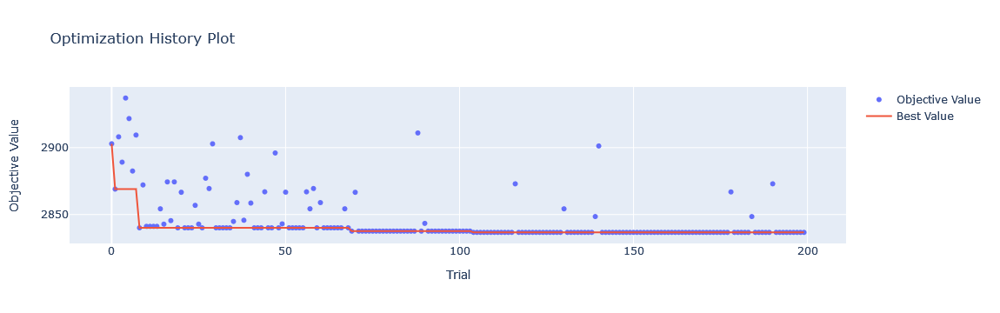

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

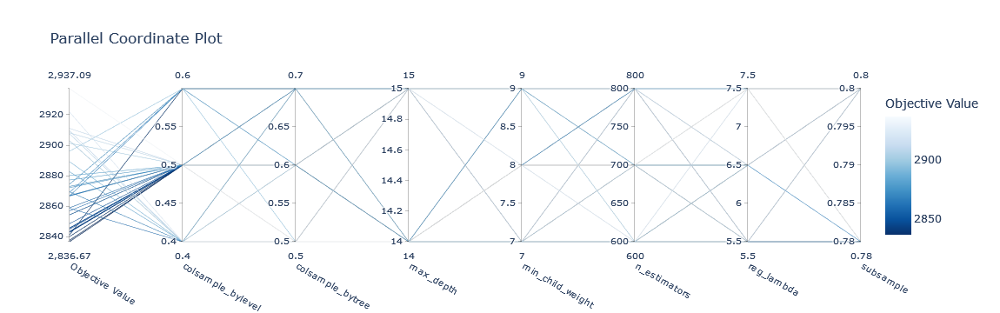

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.html')
fig.show()

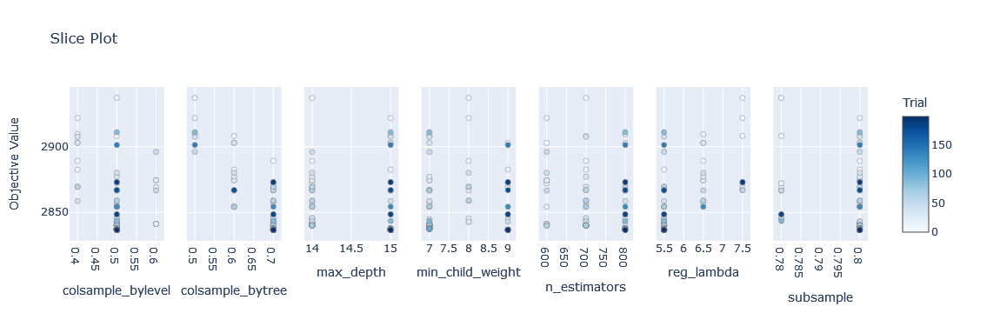

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.html')
fig.show()

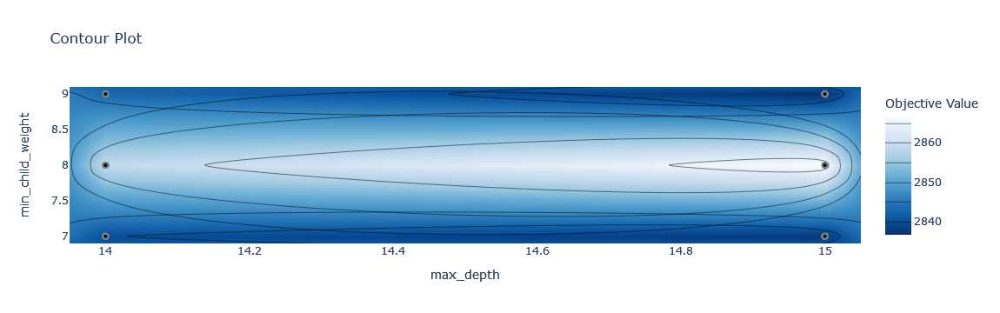

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.html')
fig.show()

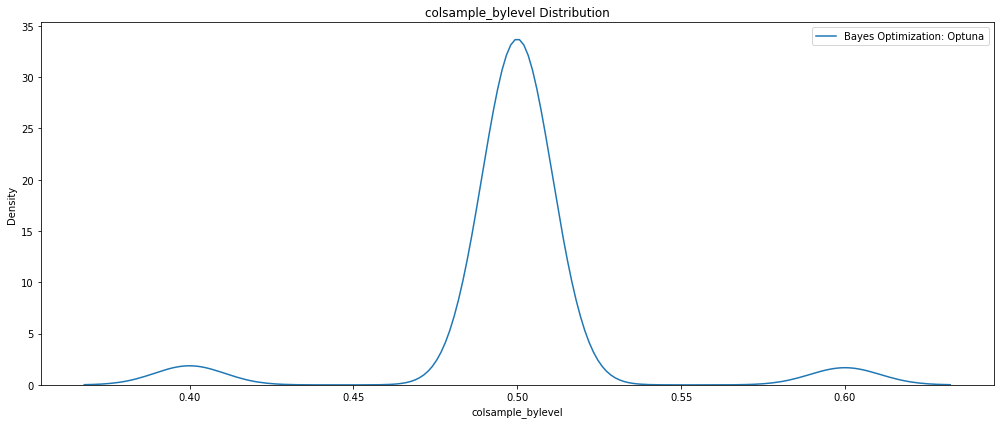

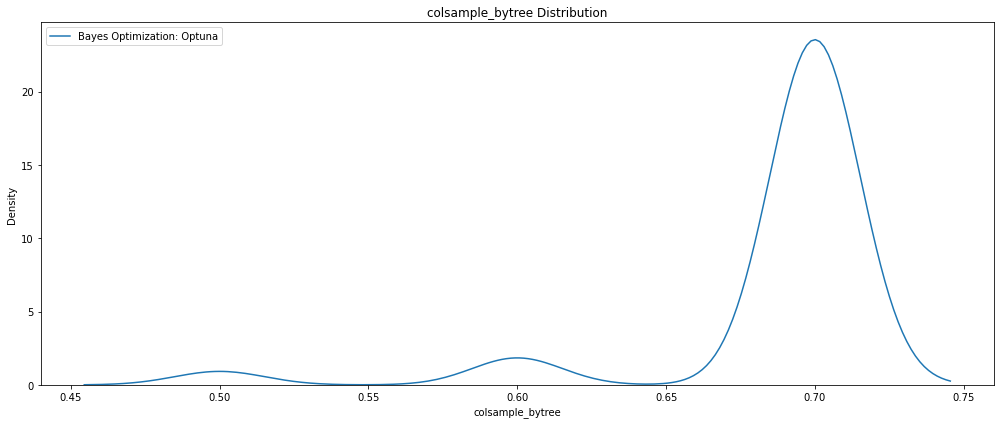

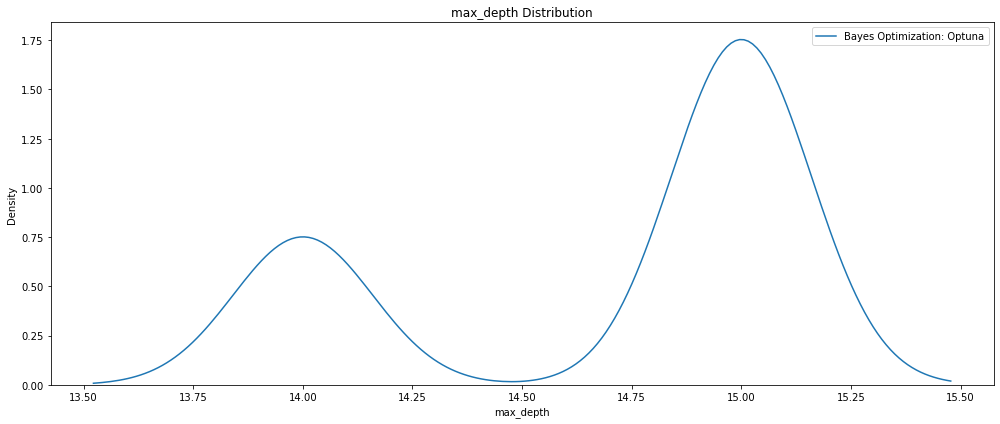

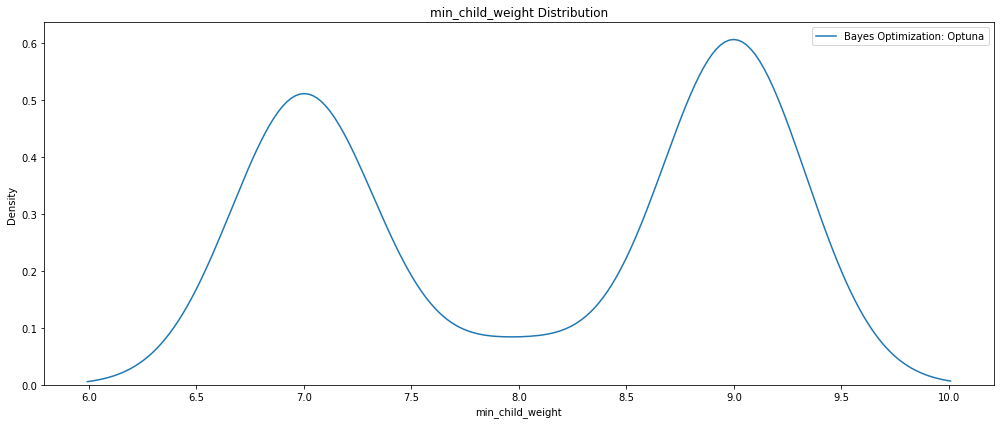

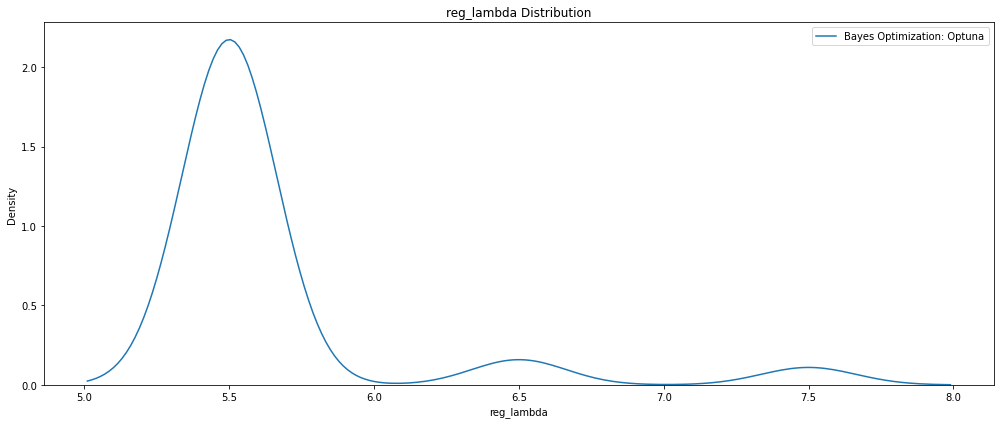

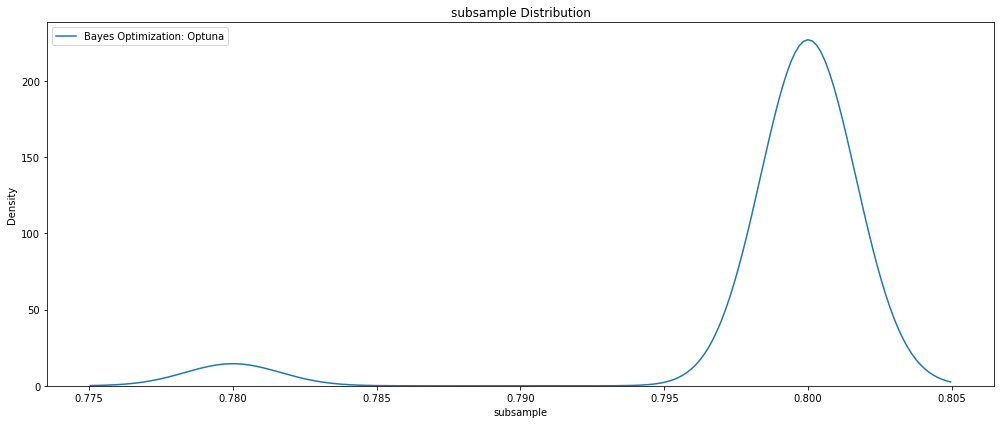

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

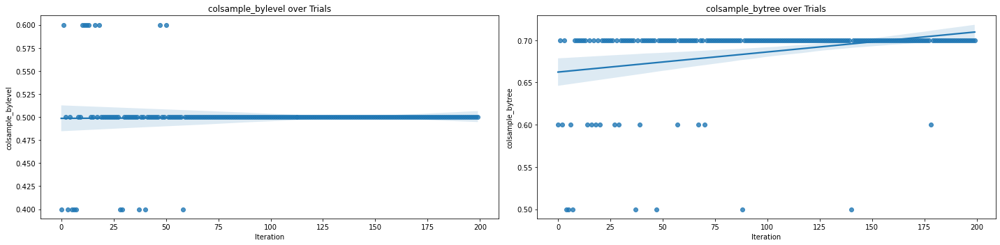

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

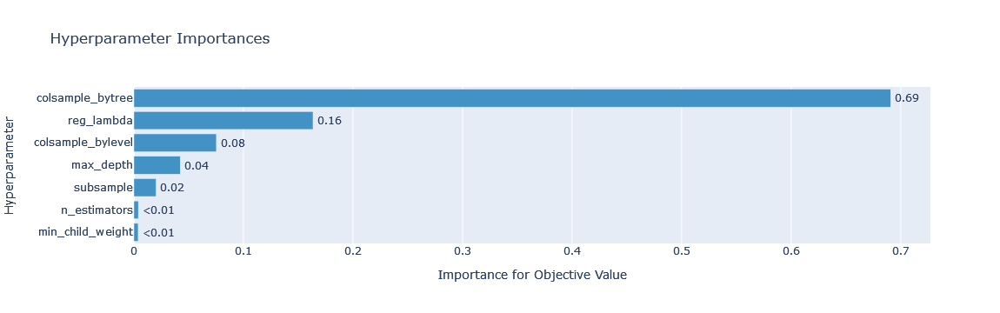

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.html')
fig.show()

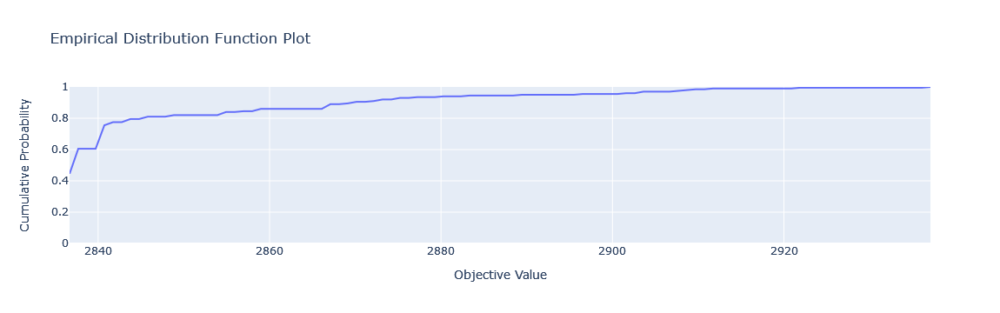

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 800,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.5,
 'min_child_weight': 9,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)
# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_3CV_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_3CV_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for XGBoost HPO GPU trials
MAE train: 919.201, test: 1684.660
MSE train: 1633389.920, test: 5393519.908
RMSE train: 1278.041, test: 2322.395
R^2 train: 0.982, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5393519.90815 MSE on the test set.
This was achieved using these conditions:
iteration                                   199
rmse                                2836.669922
datetime_start       2023-03-02 02:24:07.581266
datetime_complete    2023-03-02 02:24:21.413371
duration                 0 days 00:00:13.832105
colsample_bylevel                           0.5
colsample_bytree                            0.7
max_depth                                    15
min_child_weight                              9
n_estimators                                800
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 199, dtype: object


## 200 Trials 5CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False',
                'notes': 'xgbGPU_setParams_RTX4000_5CV_noCUML',
                'tags': 'xgbGPU_setParams_RTX4000_5CV_noCUML'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_5CV_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {       
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()
      
    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=5, 
                        metrics='rmse', as_pandas=True)
    run_time = timer() - start

    # Extract best score
    rmse = cv_results['test-rmse-mean'].values[-1]
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_5CV_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_5CV_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-02-28 12:30:13.565950
- Trial RMSE: 2819.894287


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2896.0174316000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2872.6514162


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2843.9250488


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2820.8895996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2878.3072264


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2909.0118651999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2844.702881


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2835.1903319999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2845.4333983999995


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2834.0369628


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2828.0629882000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2835.5727049999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2814.3895998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2849.9275392


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2814.3895998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2890.2629393999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2835.097705


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2828.8862792


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2835.5727049999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2828.0629882000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2835.5727049999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.4593747999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2826.2774414


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2820.9473633999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2880.8941896


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2847.5079102


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2868.7736328


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2814.7490722000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.5723632


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.6456054


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2887.3272948000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2880.8941896


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2826.2774414


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.2668458


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.894287


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2834.1131348000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2826.2774414


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.6456054


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.4593747999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2838.9476562


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.0963378


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2880.8941896


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2846.2069338


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.7151858


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2848.0738770000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.4593747999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2838.9476562


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.0963378


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2880.8941896


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.2069338


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.6456054


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2834.1131348000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.0963378


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2826.2774414


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2814.3895998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2811.6039062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.4593747999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.6456054


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2868.7736328


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.4725099999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Start Time           2023-02-28 12:30:13.565950
End Time             2023-02-28 13:41:06.961348
1:10:53


Number of finished trials: 200
Best trial: {'n_estimators': 700, 'max_depth': 14, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.6, 'min_child_weight': 7}
Lowest RMSE 2810.4725099999996


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2810.472510 2023-02-28 13:05:06.352142   
121        121  2810.472510 2023-02-28 13:13:01.154200   
122        122  2810.472510 2023-02-28 13:13:22.201484   
123        123  2810.472510 2023-02-28 13:13:43.315001   
124        124  2810.472510 2023-02-28 13:14:04.377982   
..         ...          ...                        ...   
88          88  2880.894190 2023-02-28 13:01:12.405263   
48          48  2887.327295 2023-02-28 12:46:56.194690   
17          17  2890.262939 2023-02-28 12:35:58.164065   
1            1  2896.017432 2023-02-28 12:30:24.373923   
6            6  2909.011865 2023-02-28 12:32:07.024612   

             datetime_complete               duration  colsample_bylevel  \
99  2023-02-28 13:05:23.057664 0 days 00:00:16.705522                0.6   
121 2023-02-28 13:13:18.031413 0 days 00:00:16.877213                0.6   
122 2023-02-28 13:13:39.364476 0 days 00:00:17.162992                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


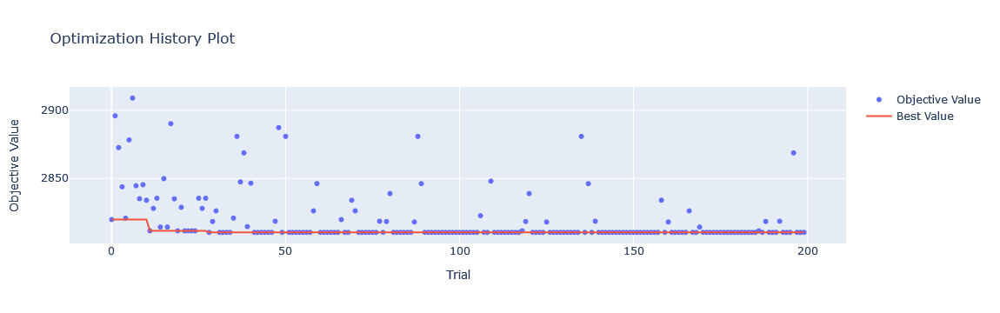

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

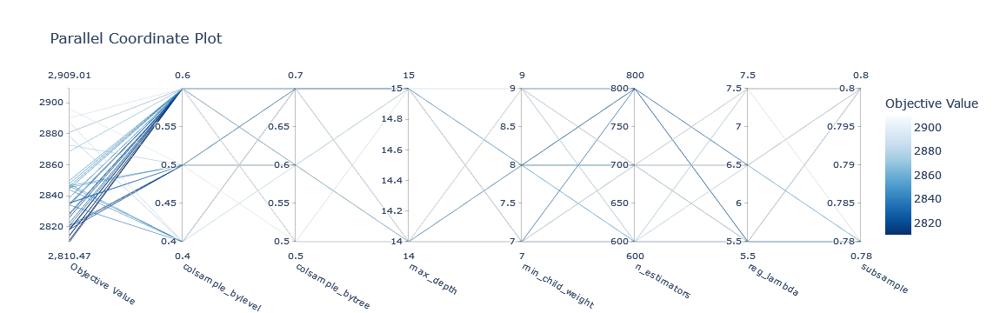

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

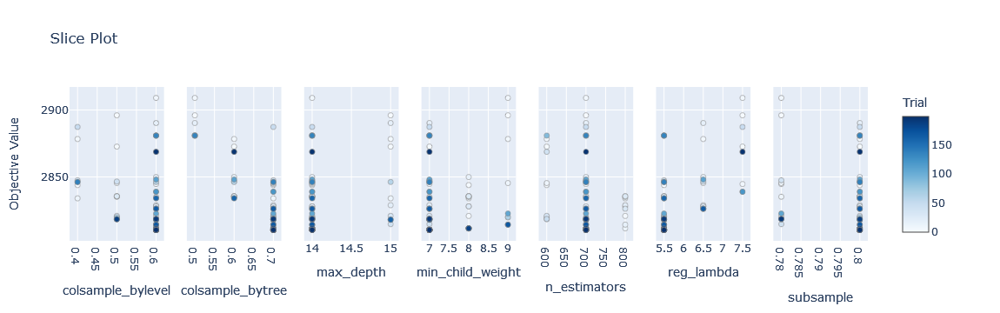

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

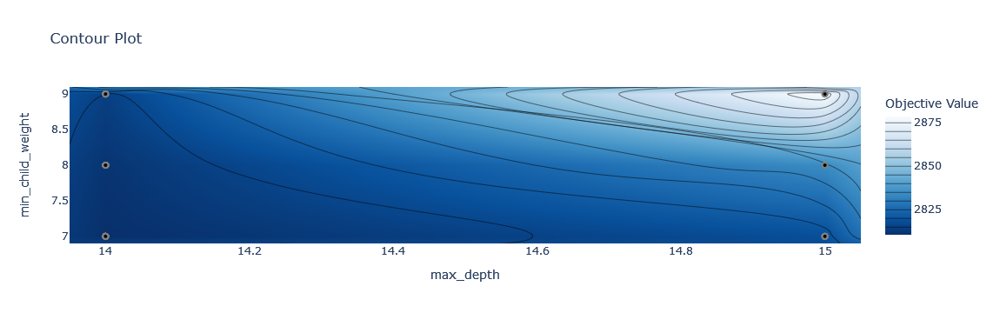

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

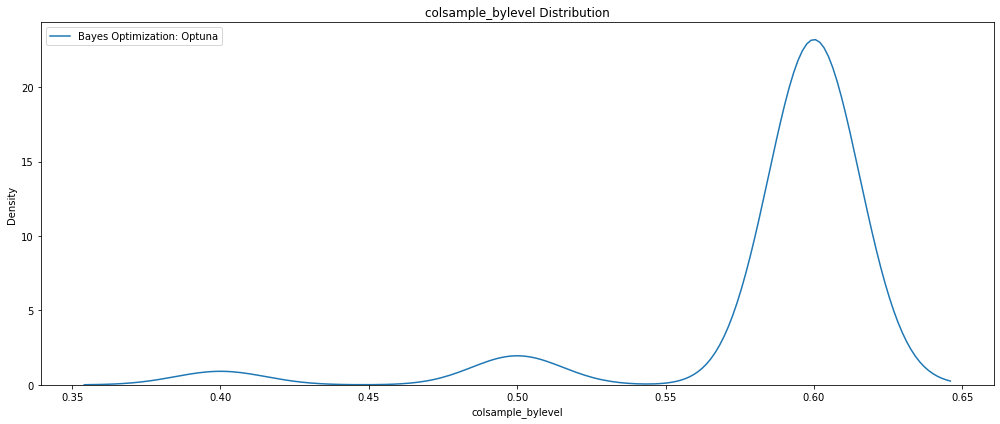

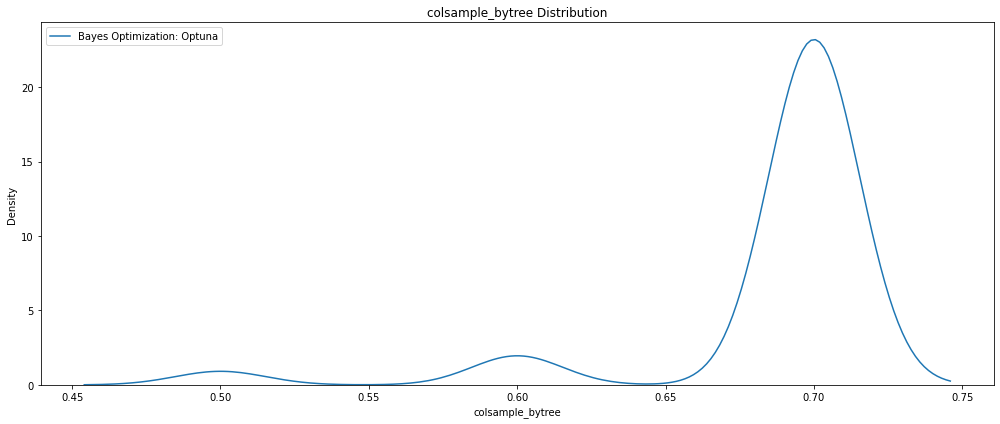

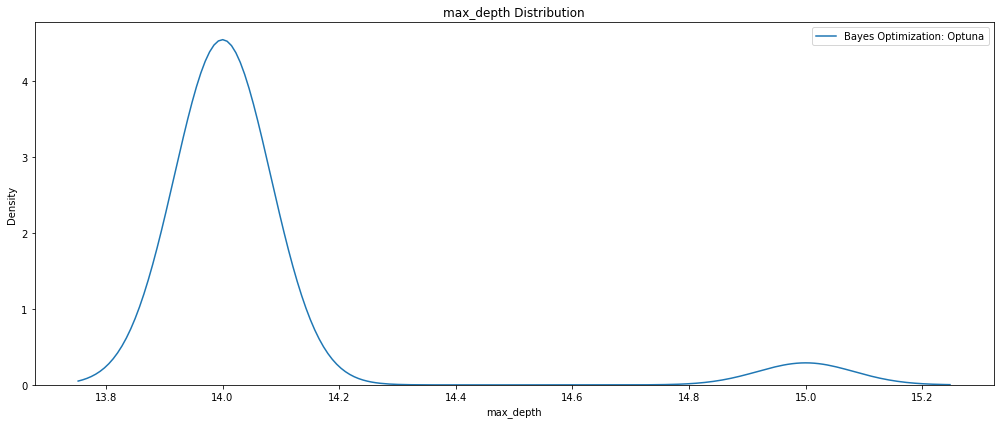

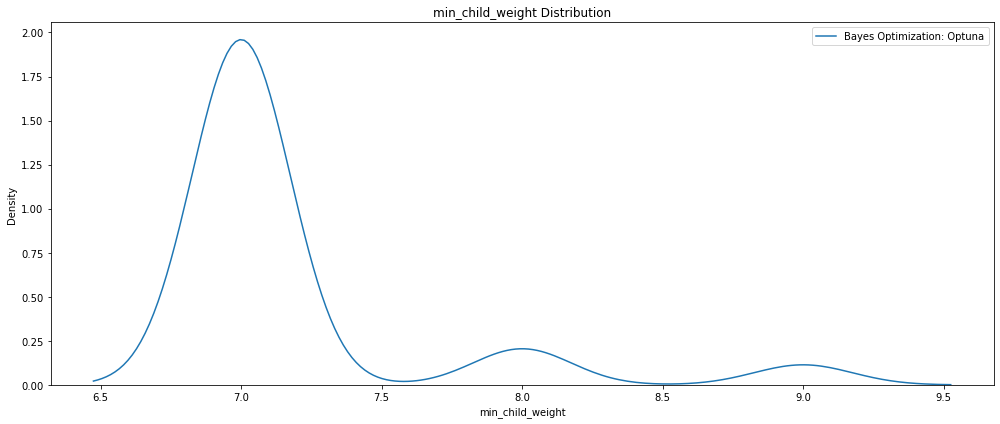

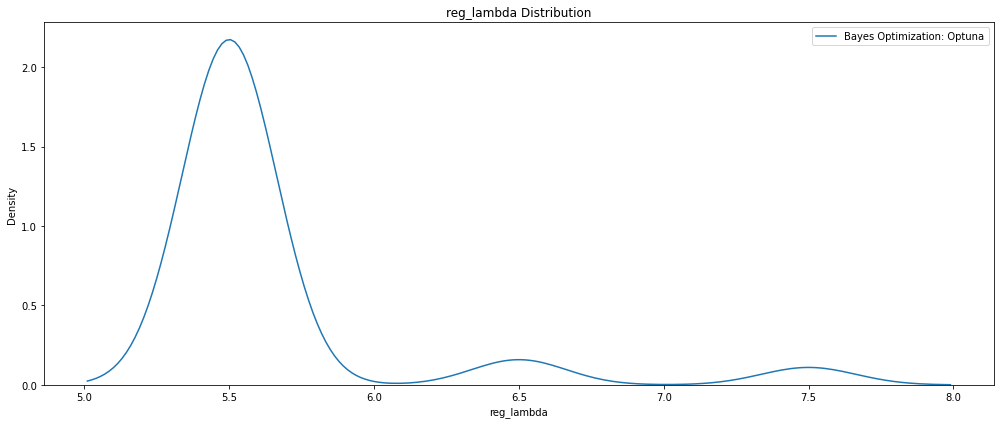

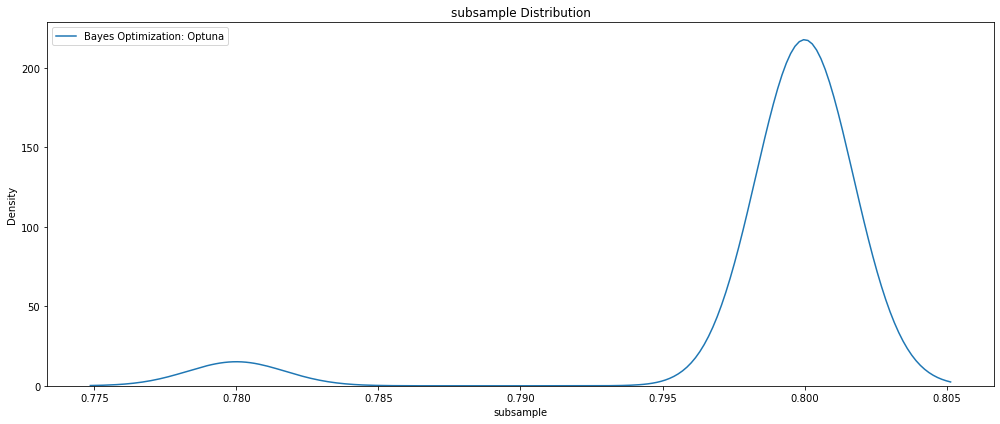

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

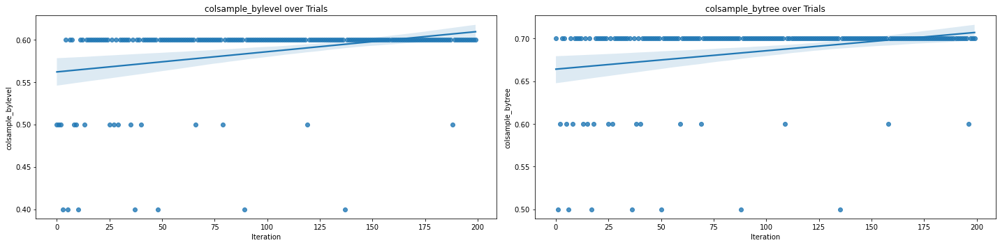

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

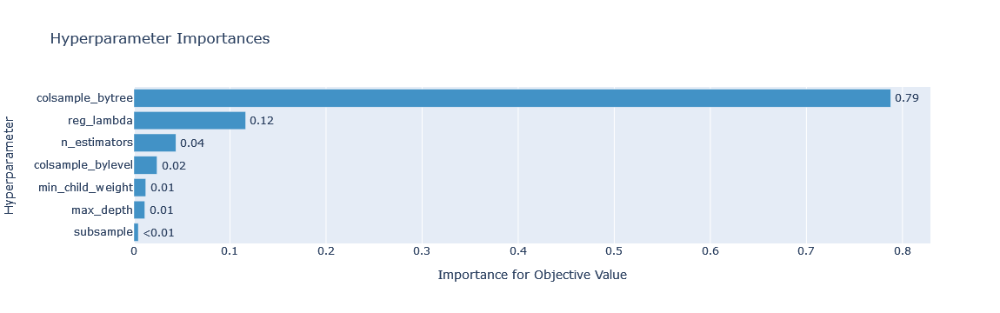

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

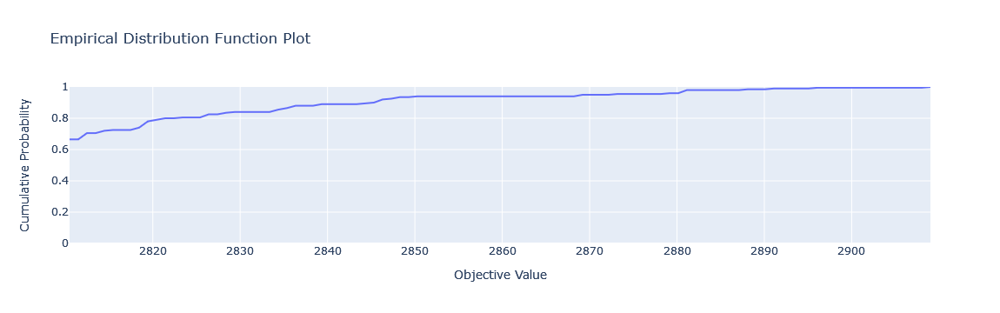

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 700,
 'max_depth': 14,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.6,
 'min_child_weight': 7,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)
# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_5CV_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_5CV_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1032.235, test: 1691.241
MSE train: 2029759.329, test: 5401147.095
RMSE train: 1424.696, test: 2324.037
R^2 train: 0.978, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5401147.09528 MSE on the test set.
This was achieved using these conditions:
iteration                                    99
rmse                                 2810.47251
datetime_start       2023-02-28 13:05:06.352142
datetime_complete    2023-02-28 13:05:23.057664
duration                 0 days 00:00:16.705522
colsample_bylevel                           0.6
colsample_bytree                            0.7
max_depth                                    14
min_child_weight                              7
n_estimators                                700
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 99, dtype: object


## 200 Trials 10CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False',
                'notes': 'xgbGPU_setParams_RTX4000_10CV_noCUML',
                'tags': 'xgbGPU_setParams_RTX4000_10CV_noCUML'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_10CV_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {       
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()
      
    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=10, 
                        metrics='rmse', as_pandas=True)
    run_time = timer() - start

    # Extract best score
    rmse = cv_results['test-rmse-mean'].values[-1]
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_10CV_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_10CV_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-03-02 02:42:46.231671


- Trial RMSE: 2827.9135742


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2817.5879393999994


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2913.7729246999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2844.4937256000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2914.6874999


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2911.1632812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2835.4018067


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2900.948169


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2849.0950927000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2834.172534


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2824.2500488


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.2831053


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.9136719


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2809.3147461


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2829.2387695


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2810.065918


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.6344727000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2839.4444581


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2831.6815674


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2807.9496827


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2821.9417725999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2829.0431395000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2819.7673583999995


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2915.3907472


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2835.2883545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2829.0431395000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2828.6089110999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2819.7673583999995


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2900.9934326000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2809.1428711


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2821.9417725999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.2240478


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2801.2282469999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2801.2282469999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2826.0844236999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2817.9171386000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2909.5851562


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2808.3857422


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2814.433911


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2808.3857422


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2880.1380127


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2829.3732179000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2814.433911


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2817.9171386000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2800.0580078


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2809.6249513


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2798.5772704


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Start Time           2023-03-02 02:42:46.231671
End Time             2023-03-02 04:04:37.891068
1:21:51


Number of finished trials: 200
Best trial: {'n_estimators': 700, 'max_depth': 14, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.5, 'min_child_weight': 8}
Lowest RMSE 2798.5772704


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
199        199  2798.577270 2023-03-02 04:04:13.187285   
177        177  2798.577270 2023-03-02 03:55:10.653231   
178        178  2798.577270 2023-03-02 03:55:35.578400   
179        179  2798.577270 2023-03-02 03:56:00.720457   
181        181  2798.577270 2023-03-02 03:56:48.957300   
..         ...          ...                        ...   
90          90  2909.585156 2023-03-02 03:19:45.406138   
5            5  2911.163281 2023-03-02 02:44:48.484531   
2            2  2913.772925 2023-03-02 02:43:36.911438   
4            4  2914.687500 2023-03-02 02:44:25.457163   
39          39  2915.390747 2023-03-02 02:59:09.091423   

             datetime_complete               duration  colsample_bylevel  \
199 2023-03-02 04:04:32.951922 0 days 00:00:19.764637                0.5   
177 2023-03-02 03:55:30.601609 0 days 00:00:19.948378                0.5   
178 2023-03-02 03:55:55.864629 0 days 00:00:20.286229                0.5   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


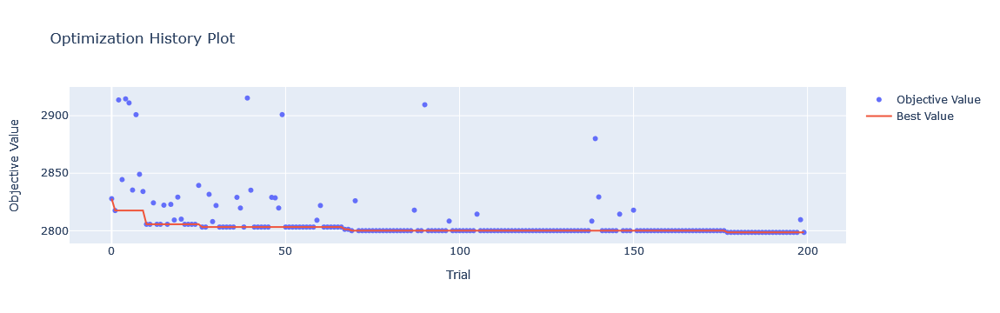

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

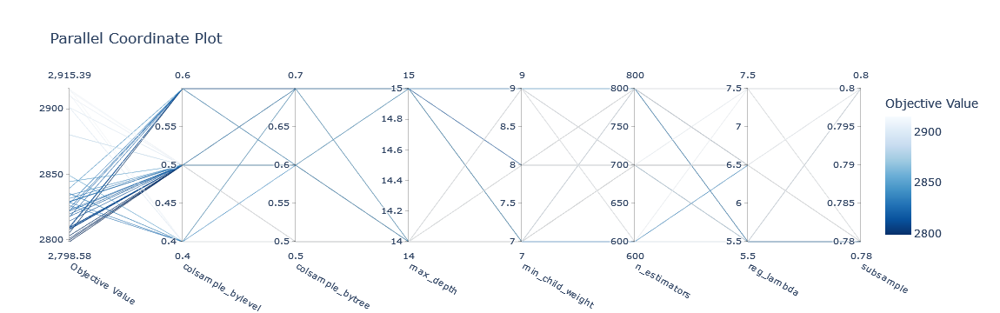

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

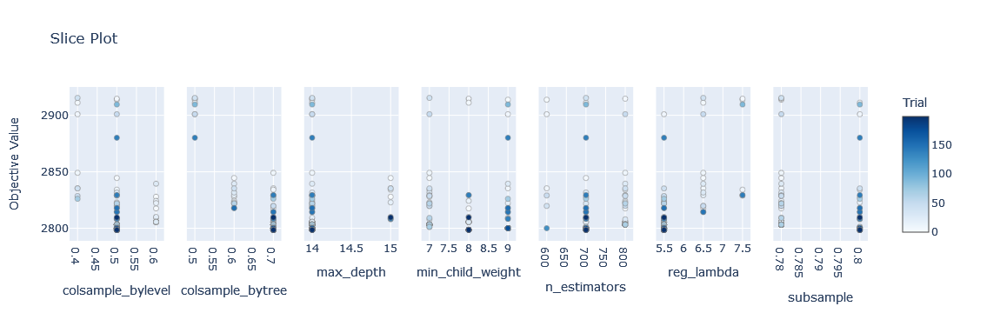

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

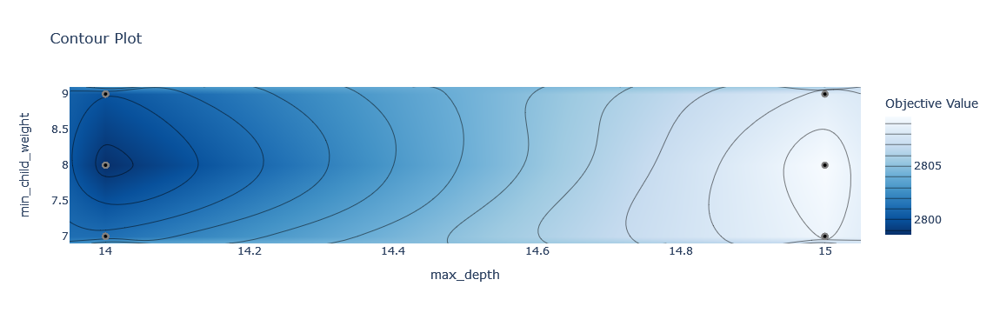

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

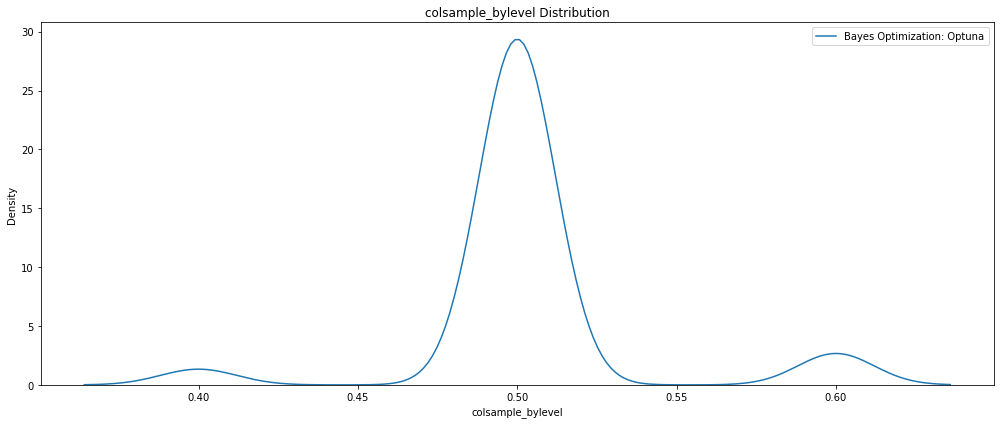

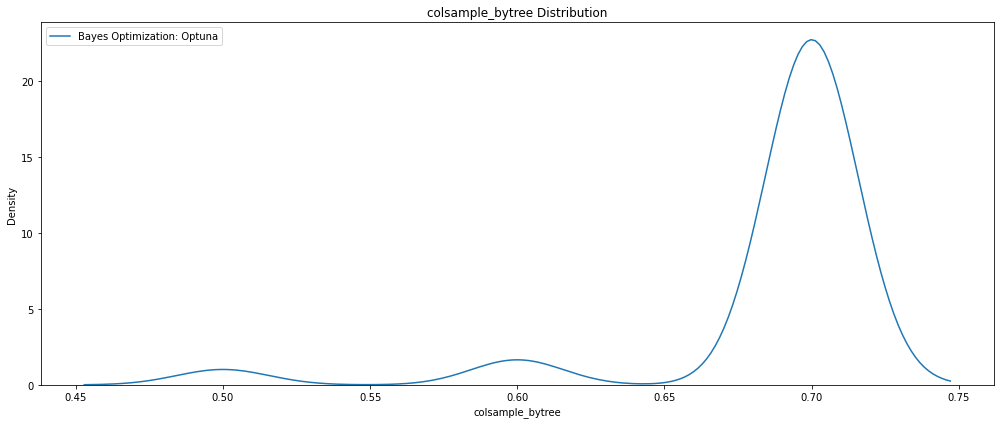

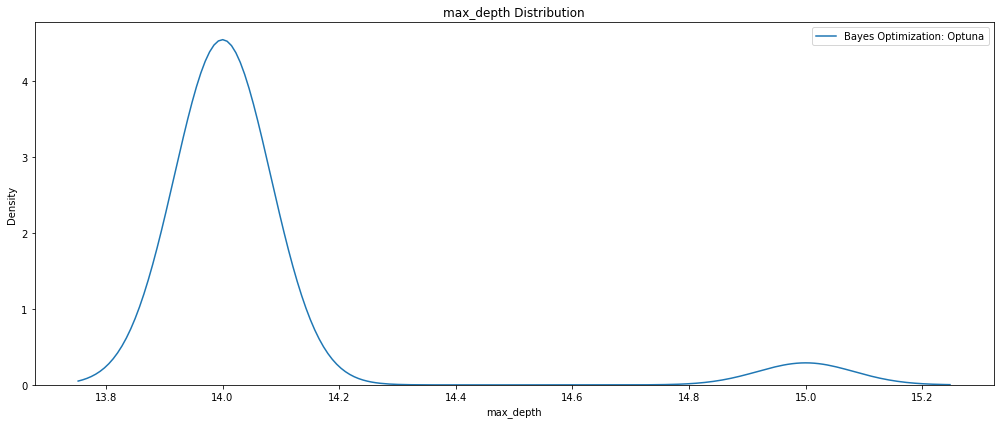

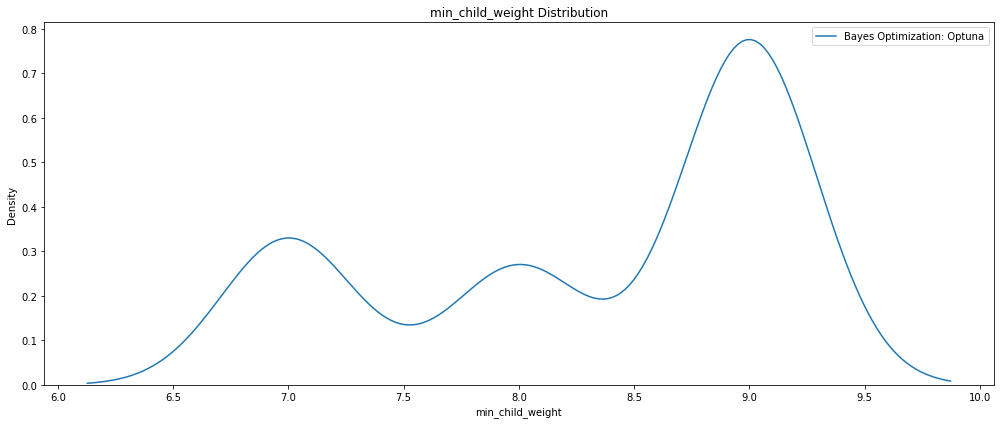

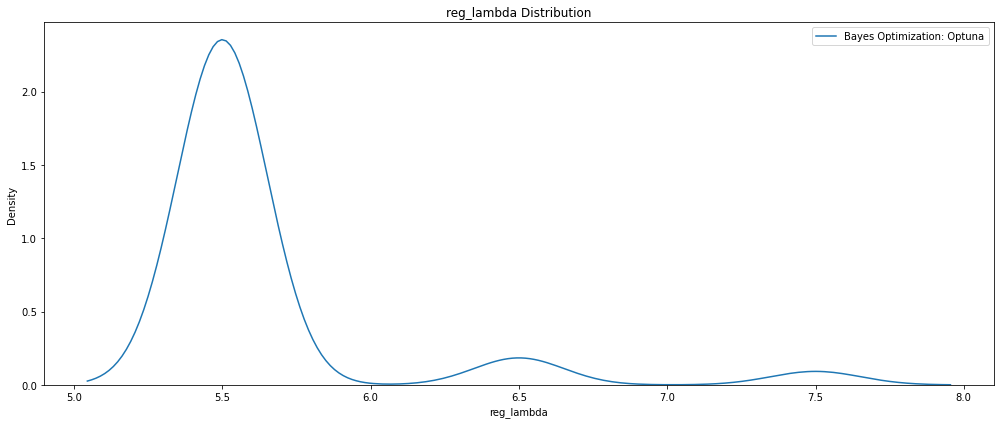

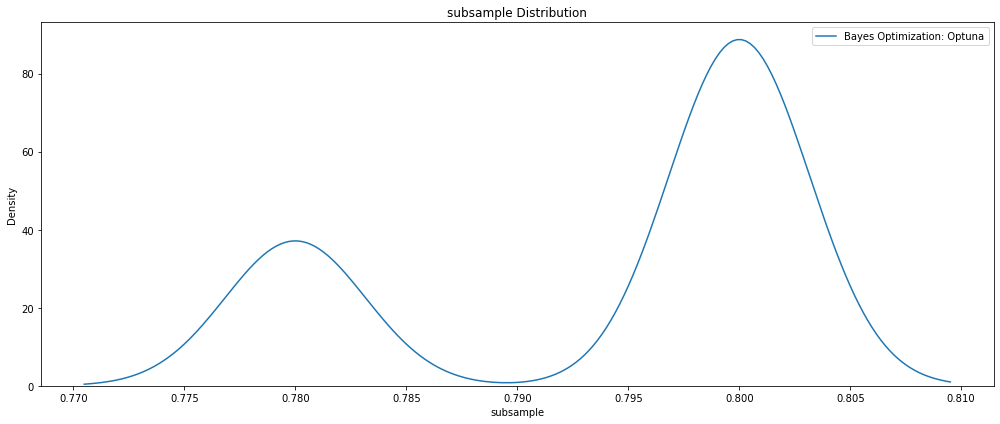

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

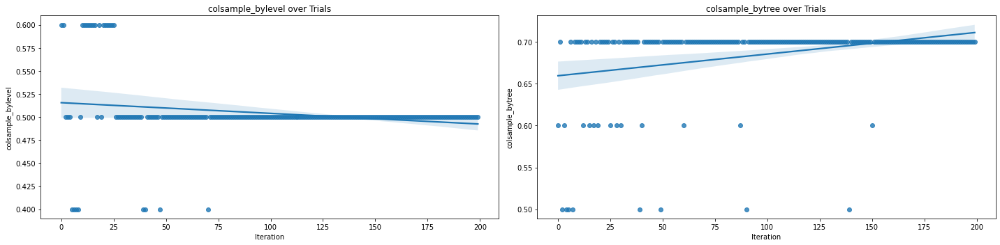

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

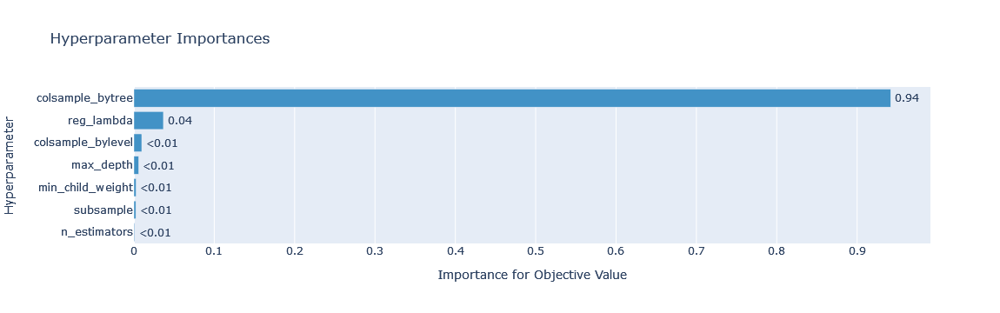

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

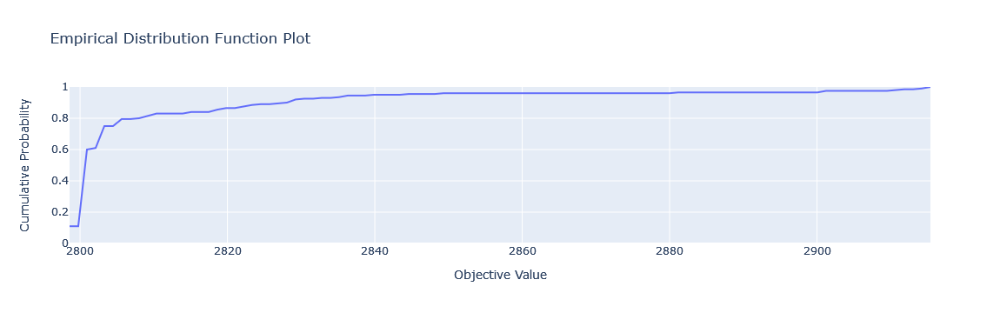

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 700,
 'max_depth': 14,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.5,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)
# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_10CV_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_10CV_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1084.934, test: 1693.636
MSE train: 2226121.053, test: 5413187.740
RMSE train: 1492.019, test: 2326.626
R^2 train: 0.976, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5413187.73955 MSE on the test set.
This was achieved using these conditions:
iteration                                   199
rmse                                 2798.57727
datetime_start       2023-03-02 04:04:13.187285
datetime_complete    2023-03-02 04:04:32.951922
duration                 0 days 00:00:19.764637
colsample_bylevel                           0.5
colsample_bytree                            0.7
max_depth                                    14
min_child_weight                              8
n_estimators                                700
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 199, dtype: object


# Train/Test

## 200 Trials Train/Test Scikit-Learn

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False',
                'notes': 'xgbGPU_setParams_RTX4000_trainTest_noCUML',
                'tags': 'xgbGPU_setParams_RTX4000_trainTest_noCUML'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()

    # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(test_label, y_pred_val, squared=False)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-26 06:22:06.590938


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


wandb: ERROR Error while calling W&B API: internal database error (<Response [500]>)


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Load the study to continue training
study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_wb.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Number of finished trials: 182
Best trial: {'n_estimators': 800, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2316.7207965972175


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=19, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-02-28 05:57:44.348032


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Start Time           2023-02-28 05:57:44.348032
End Time             2023-02-28 06:33:19.433393
0:35:35


Number of finished trials: 201
Best trial: {'n_estimators': 800, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2316.7207965972175


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
171        171  2316.720797 2023-02-26 11:54:01.345774   
199        199  2316.720797 2023-02-28 06:29:38.556858   
167        167  2316.720797 2023-02-26 11:46:17.697075   
168        168  2316.720797 2023-02-26 11:48:13.400163   
169        169  2316.720797 2023-02-26 11:50:09.871784   
..         ...          ...                        ...   
3            3  2329.540470 2023-02-26 06:26:30.716588   
39          39  2329.678827 2023-02-26 07:29:56.656711   
6            6  2330.374810 2023-02-26 06:30:36.029208   
5            5  2332.473006 2023-02-26 06:29:28.590756   
181        181          NaN 2023-02-26 12:13:23.873781   

             datetime_complete               duration  colsample_bylevel  \
171 2023-02-26 11:55:54.143856 0 days 00:01:52.798082                0.6   
199 2023-02-28 06:31:26.714324 0 days 00:01:48.157466                0.6   
167 2023-02-26 11:48:10.922383 0 days 00:01:53.225308                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

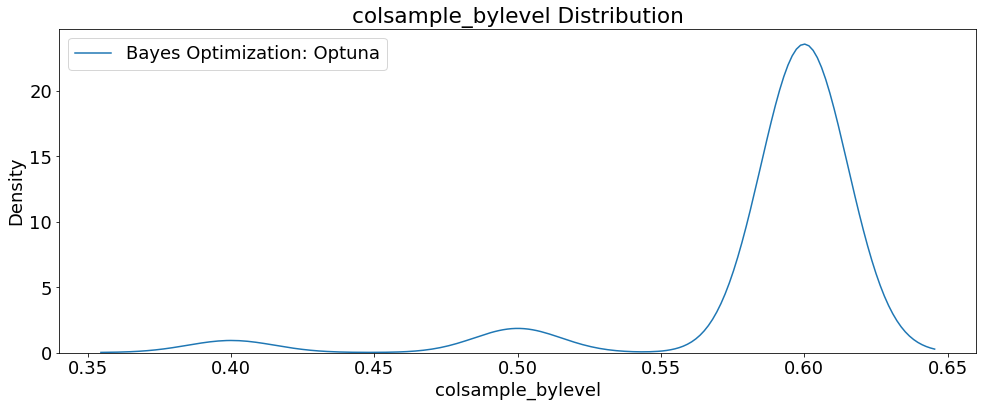

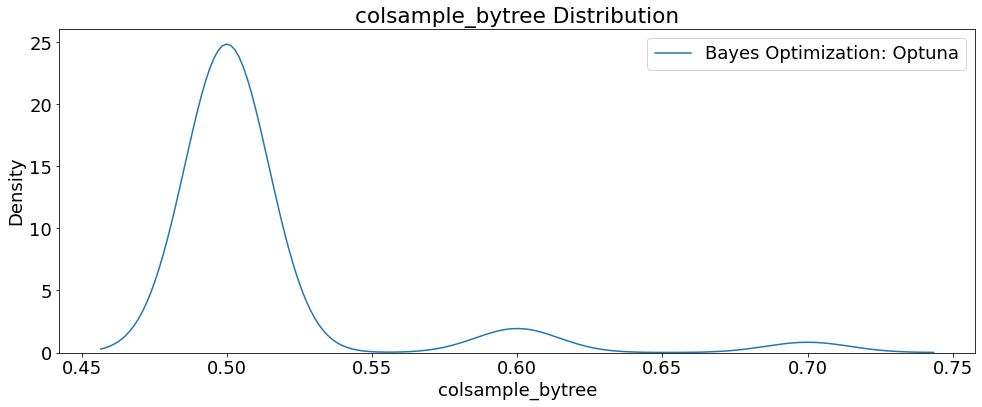

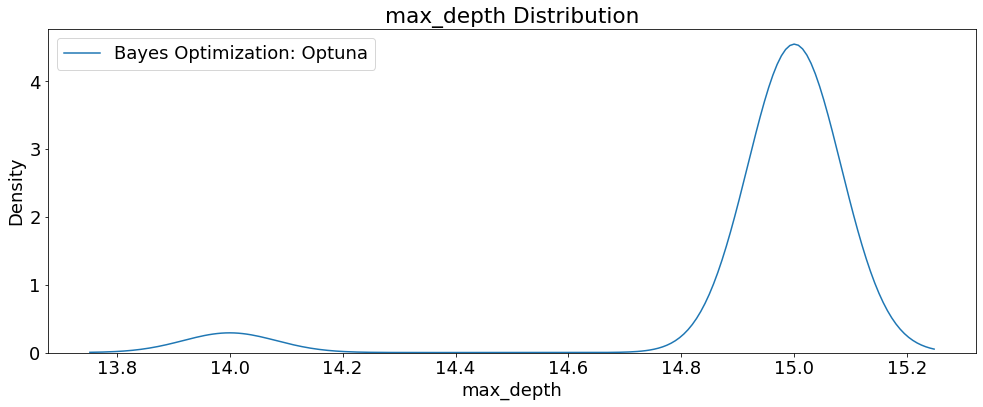

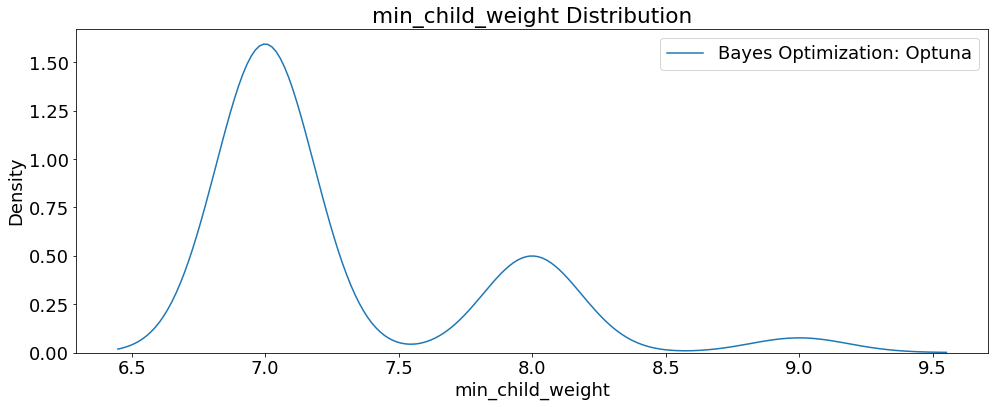

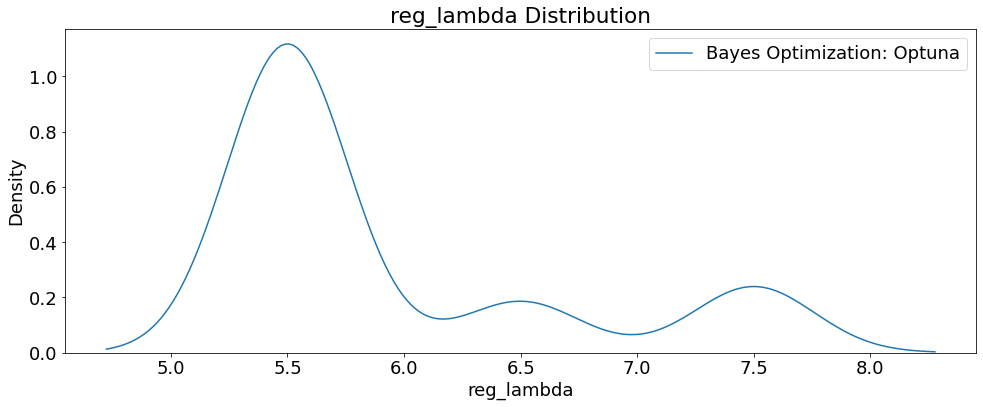

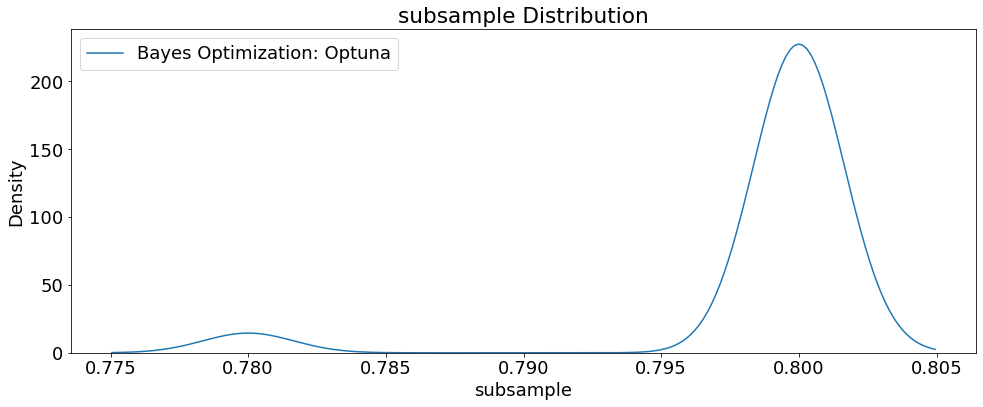

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

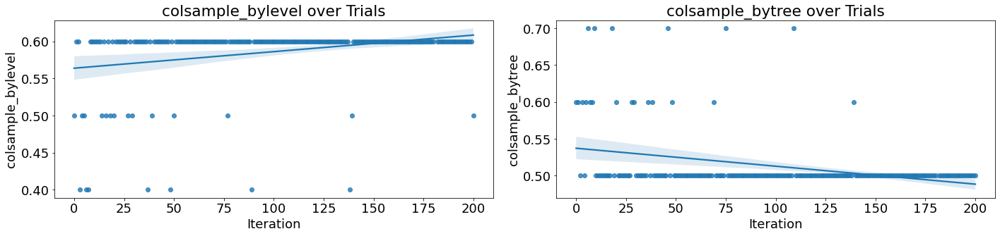

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 800,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.5,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)
# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_trainTest_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_trainTest_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for XGBoost HPO GPU trials
MAE train: 946.037, test: 1683.412
MSE train: 1742288.827, test: 5367195.249
RMSE train: 1319.958, test: 2316.721
R^2 train: 0.981, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5367195.24939 MSE on the test set.
This was achieved using these conditions:
iteration                                    99
rmse                                 2810.47251
datetime_start       2023-02-28 13:05:06.352142
datetime_complete    2023-02-28 13:05:23.057664
duration                 0 days 00:00:16.705522
colsample_bylevel                           0.6
colsample_bytree                            0.7
max_depth                                    14
min_child_weight                              7
n_estimators                                700
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 99, dtype: object


## 200 Trials Train/Test DMatrix No EvalSet

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False',
                'notes': 'xgbGPU_setParams_RTX4000_trainTest_DMatrix_noCUML',
                'tags': 'xgbGPU_setParams_RTX4000_trainTest_DMatrix_noCUML'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    '''
    Objective function to tune a `XGBoostRegressor` model.
    '''
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'objective':'reg:squarederror',
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'verbose': False,
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()

    # Train the model# Train the model
    model = xgb.train(params_xgb_optuna, dtrain)
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(dtest)
    rmse = mean_squared_error(test_label, y_pred_val, 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-03-04 16:38:36.754862


Trial RMSE: 2825.6164476239915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2892.732992578804


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2825.5326398005077


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2876.9149878190265


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2796.9012344916787


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2845.755541520259


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2819.5005354512223


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2842.311952447924


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2833.8198119318586


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2817.2470672866543


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2828.593313672686


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2791.466071978346


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2889.995484544433


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2815.5669410434625


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2804.8814007207948


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2787.9629084719263


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2787.9629084719263


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2787.9629084719263


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2787.9629084719263


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2787.9629084719263


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2819.650716492521


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2814.450428451045


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2893.6250107151313


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2788.717225626854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2798.0097153258594


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2842.6721461248962


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2802.8610593416092


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2814.450428451045


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2808.0873066335434


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2872.6548477503547


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2802.8610593416092


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2811.1292949567896


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2805.5044208577065


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2798.2638382597274


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2788.717225626854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2814.450428451045


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2789.3232038793594


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2872.6548477503547


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2812.63747347832


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2788.717225626854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2786.136683698545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2791.888376721313


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2799.812619934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2799.9488461103915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2874.6152911051104


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2820.9672563954996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2791.888376721313


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2799.9488461103915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2799.812619934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2784.2744922463503


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2792.200870422241


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Start Time           2023-03-04 16:38:36.754862
End Time             2023-03-04 17:36:24.634476
0:57:47


Number of finished trials: 200
Best trial: {'n_estimators': 700, 'max_depth': 14, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.5, 'min_child_weight': 8}
Lowest RMSE 2784.2744922463503


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2784.274492 2023-03-04 17:07:23.012980   
125        125  2784.274492 2023-03-04 17:14:55.441055   
124        124  2784.274492 2023-03-04 17:14:38.445110   
123        123  2784.274492 2023-03-04 17:14:21.551584   
122        122  2784.274492 2023-03-04 17:14:04.138397   
..         ...          ...                        ...   
147        147  2874.615291 2023-03-04 17:21:09.348967   
3            3  2876.914988 2023-03-04 16:39:31.143347   
17          17  2889.995485 2023-03-04 16:43:38.066785   
1            1  2892.732993 2023-03-04 16:38:58.121425   
35          35  2893.625011 2023-03-04 16:48:50.314883   

             datetime_complete               duration  colsample_bylevel  \
99  2023-03-04 17:07:35.609591 0 days 00:00:12.596611                0.5   
125 2023-03-04 17:15:08.103043 0 days 00:00:12.661988                0.5   
124 2023-03-04 17:14:51.173372 0 days 00:00:12.728262                0.5   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

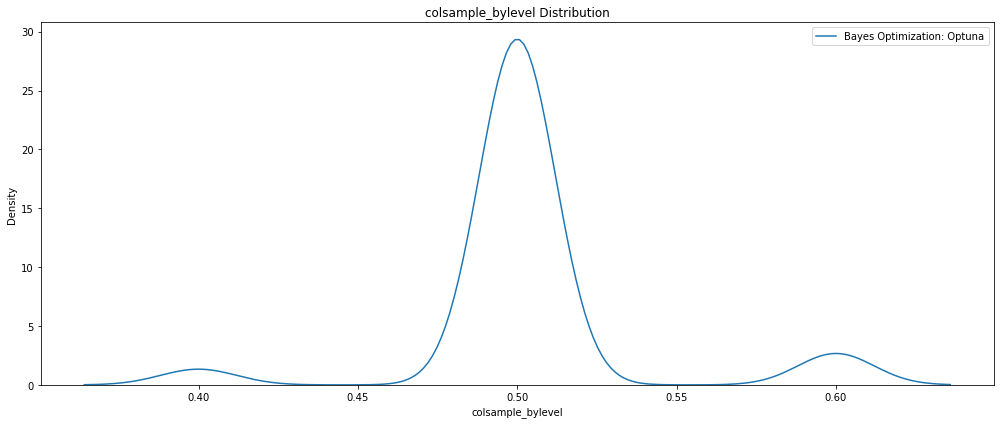

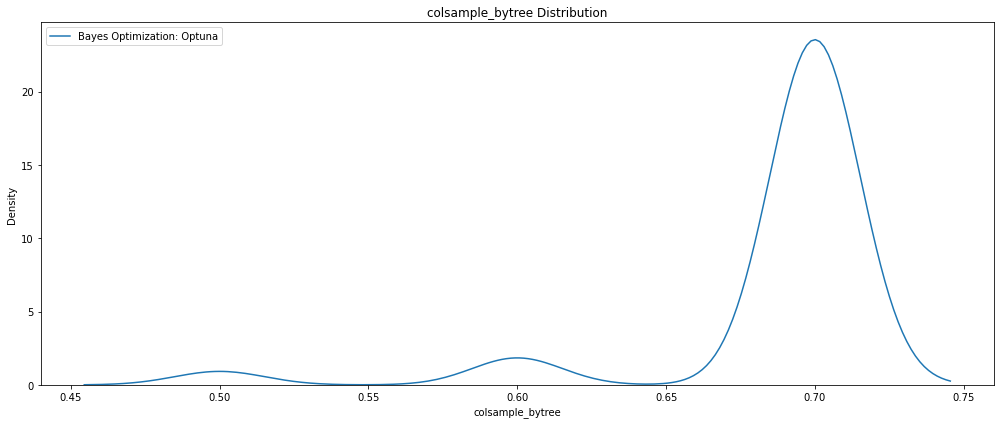

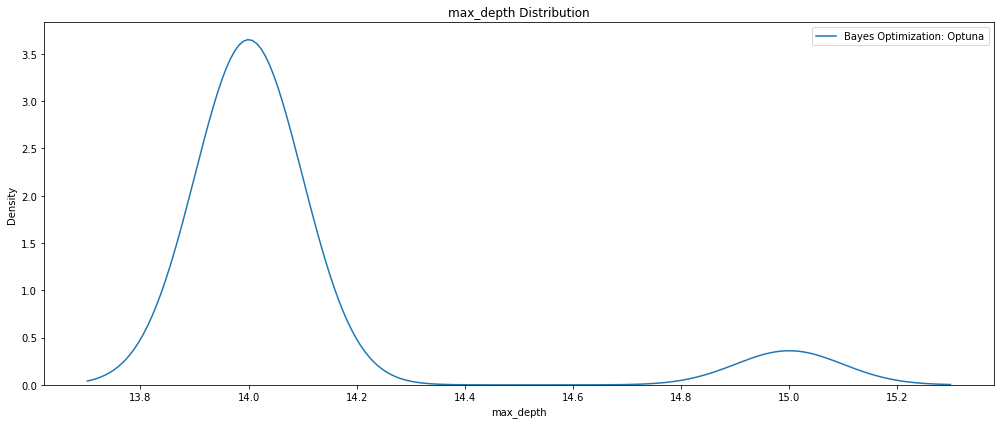

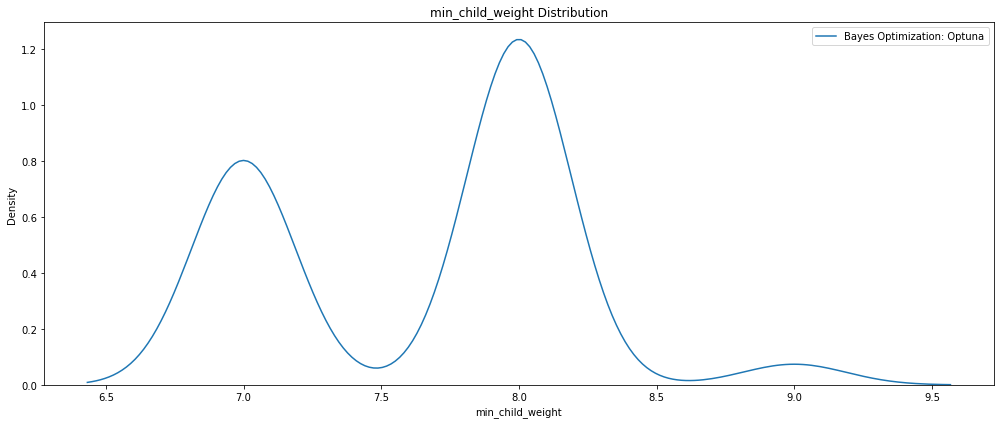

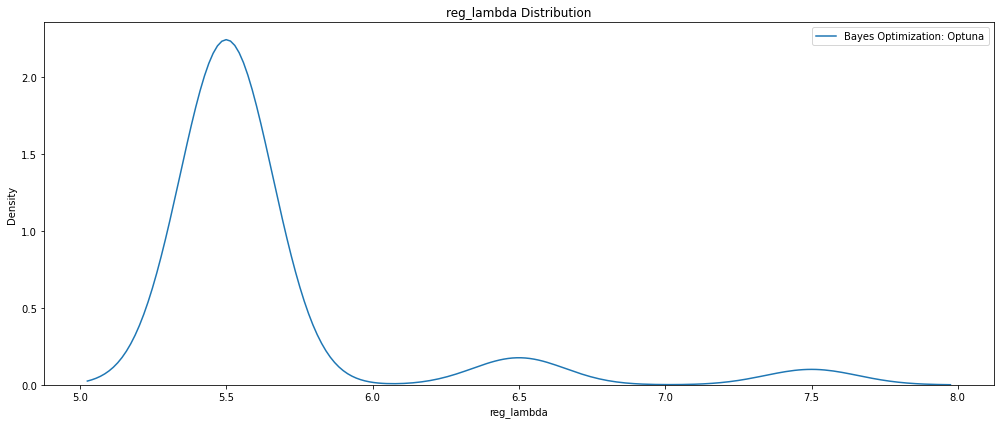

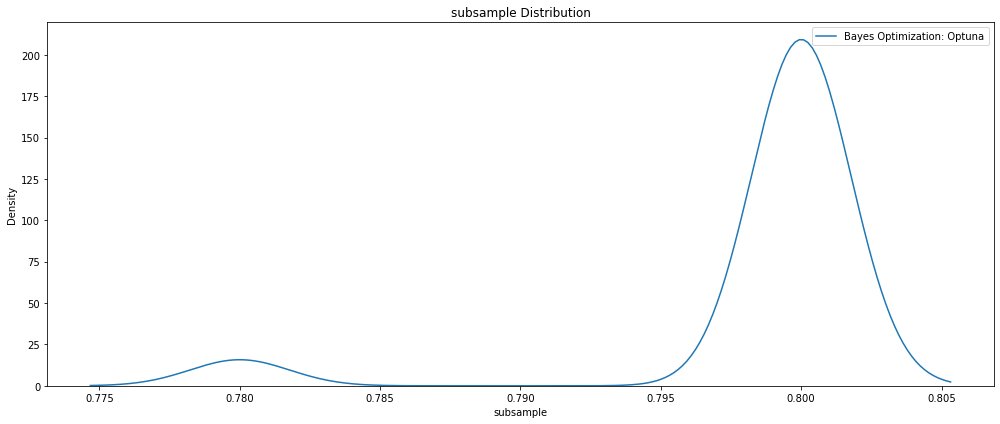

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

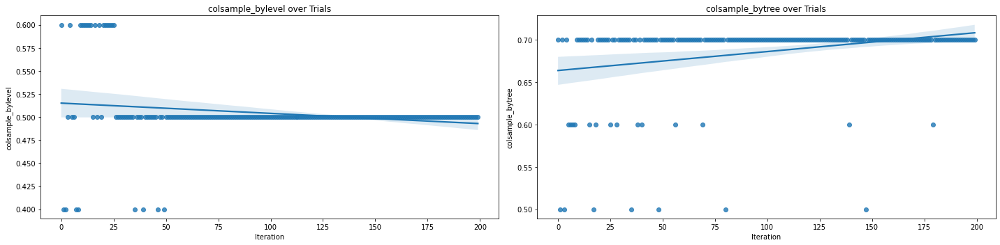

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 700,
 'max_depth': 14,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.5,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)
# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials_GPU_setParams_RTX4000_trainTest_DMatrix_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials_GPU_setParams_RTX4000_trainTest_DMatrix_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1084.934, test: 1693.636
MSE train: 2226121.053, test: 5413187.740
RMSE train: 1492.019, test: 2326.626
R^2 train: 0.976, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5413187.73955 MSE on the test set.
This was achieved using these conditions:
iteration                                    99
rmse                                2784.274492
datetime_start       2023-03-04 17:07:23.012980
datetime_complete    2023-03-04 17:07:35.609591
duration                 0 days 00:00:12.596611
colsample_bylevel                           0.5
colsample_bytree                            0.7
max_depth                                    14
min_child_weight                              8
n_estimators                                700
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 99, dtype: object
